In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import json

PROPERTY = 'fire_size'

df = pd.read_csv('./data/FW_Veg_Rem_Combined.csv')

cont_columns_prefix = ['Prec_pre_', "Temp_pre_", "Wind_pre_", "Hum_pre_"]
columns_suffix = [7, 15, 30]

weather_columns = [ x + str(y) for x in cont_columns_prefix for y in columns_suffix]
df = df[(df.loc[:, weather_columns] != -1).all(axis=1) & (df.loc[:, weather_columns] != 0).all(axis=1)]

In [95]:
#BAsesian network preparation

!git clone https://github.com/ITMO-NSS-team/BAMT.git
!pip install -r BAMT/requirements.txt

import os, sys

sys.path.append(os.path.join(os.path.dirname('./BAMT'), "BAMT"))

from bayesian.train_bn import structure_learning, parameter_learning
from preprocess.discretization import get_nodes_type, discretization, code_categories, get_nodes_sign
from bayesian.save_bn import save_structure, save_params, read_structure, read_params
from bayesian.sampling import generate_synthetics
from bayesian.calculate_accuracy import calculate_acc
from external.libpgm.hybayesiannetwork import HyBayesianNetwork
from visualization.visualization import draw_BN

fatal: destination path 'BAMT' already exists and is not an empty directory.


In [96]:
bayesian_net_columns = ['remoteness', 'latitude', 'longitude', 'Temp_pre_7', 'Temp_pre_15', 'Temp_pre_30', 'Prec_pre_30', 'Hum_pre_7', 'Hum_pre_15', 'Hum_pre_30', 'stat_cause_descr']
bayesian_net_columns_cont = ['remoteness', 'latitude', 'longitude', 'Temp_pre_7', 'Temp_pre_15', 'Temp_pre_30', 'Prec_pre_30', 'Hum_pre_7', 'Hum_pre_15', 'Hum_pre_30']
to_drop = filter(lambda col: col != PROPERTY and not col in bayesian_net_columns, df.columns)

df_bayes = df.drop(to_drop, axis=1)
df_bayes['stat_cause_descr'] = df_bayes['stat_cause_descr'].apply(lambda x: str(x))

for col in bayesian_net_columns_cont:
    df_bayes[col] = df_bayes[col].apply(lambda x: float(x))

df_bayes.dropna(inplace=True)
df_bayes.reset_index(inplace=True, drop=True)
df_bayes.head(10)

,fire_size,stat_cause_descr,latitude,longitude,Temp_pre_30,Temp_pre_15,Temp_pre_7,Hum_pre_30,Hum_pre_15,Hum_pre_7,Prec_pre_30,remoteness
0,60.0,Arson,34.947800,-88.722500,4.971930,5.782766,5.558750,75.531629,75.868613,76.812834,168.8,0.194544
1,1.0,Campfire,30.904720,-93.557500,16.851939,16.997783,20.434783,72.899478,75.061381,77.924623,28.4,0.241894
2,8.3,Debris Burning,30.845339,-83.127987,8.410983,9.007193,8.209000,71.260870,69.281030,64.797980,76.3,0.146888
3,1.0,Miscellaneous,42.731934,-77.905976,5.181473,6.003609,7.773430,68.640553,69.556263,63.966184,52.9,0.094048
4,20.0,Arson,31.122200,-88.099400,24.566175,25.548871,25.232870,73.717979,74.603325,69.440594,93.7,0.191512
5,1.2,Debris Burning,48.833000,-99.783600,-0.891635,0.372659,-4.273834,77.575012,75.963981,71.173116,21.2,0.292303
6,2.0,Debris Burning,33.669209,-95.490213,31.019278,30.145009,29.623506,50.607514,51.316384,45.219124,1.8,0.257938
7,20.0,Debris Burning,32.565000,-96.175100,28.130937,27.080402,27.213542,58.742931,61.828715,67.115183,38.6,0.265120
8,55.0,Debris Burning,37.464589,-81.491224,8.904800,12.492723,11.735795,56.238671,49.527316,40.645349,54.5,0.127992
9,2.0,Debris Burning,47.210287,-93.472820,4.751852,6.529630,5.023810,54.656786,60.538462,64.083333,11.6,0.233242


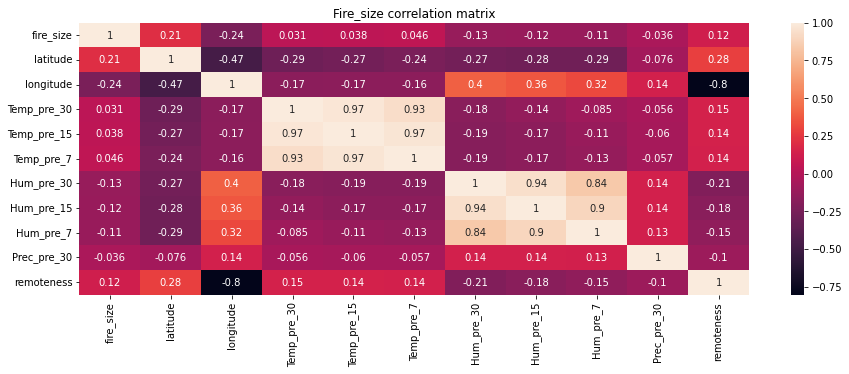

In [97]:
fig, ax = plt.subplots(1, 1, figsize=(15, 5))

sns.heatmap(df_bayes.corr(), annot = True)
plt.title('Fire_size correlation matrix')
plt.show()

In [98]:
nodes_type = get_nodes_type(df_bayes)
nodes_sign = get_nodes_sign(df_bayes)

nodes_type

{'fire_size': 'cont',
 'stat_cause_descr': 'disc',
 'latitude': 'cont',
 'longitude': 'cont',
 'Temp_pre_30': 'cont',
 'Temp_pre_15': 'cont',
 'Temp_pre_7': 'cont',
 'Hum_pre_30': 'cont',
 'Hum_pre_15': 'cont',
 'Hum_pre_7': 'cont',
 'Prec_pre_30': 'cont',
 'remoteness': 'cont'}

In [99]:
coded_data, coder = code_categories(df_bayes, 'label', ['stat_cause_descr'])
discrete_data, coder = discretization(coded_data, 'equal_frequency', bayesian_net_columns_cont)

In [100]:
to_drop = filter(lambda col: not col in ['latitude', 'longitude', 'fire_size', 'Hum_pre_7', 'remoteness', 'stat_cause_descr'], df_bayes.columns)

df_bayes_val = df_bayes.drop(to_drop, axis=1)

In [103]:
#stats and predictions MANUALL
struct_manual = {
    "V": ['latitude', 'longitude', 'fire_size', 'Hum_pre_7', 'remoteness', 'stat_cause_descr'],
    "E": [
        ['latitude', 'fire_size'],
        ['longitude', 'fire_size'],
        ['remoteness', 'fire_size'],
        ['stat_cause_descr', 'fire_size'],
        ['Hum_pre_7', 'fire_size']
    ]
}

struct_manual = {"V": ["fire_size", "stat_cause_descr", "latitude", "longitude", "Temp_pre_30", "Temp_pre_15", "Temp_pre_7", "Hum_pre_30", "Hum_pre_15", "Hum_pre_7", "Prec_pre_30", "remoteness"], "E": [['latitude', 'fire_size'],
        ['longitude', 'fire_size'],
        ['remoteness', 'fire_size'],
        ['stat_cause_descr', 'fire_size'],
        ['Hum_pre_7', 'fire_size']]}

params_manual = parameter_learning(discrete_data, nodes_type, struct_manual, 'simple')
save_params(params_manual, 'params_manual')
save_structure(struct_manual, 'struct_manual')

params_manual = read_params('params_manual')
struct_manual = read_structure('struct_manual')

bayes_man = HyBayesianNetwork(struct_manual, params_manual)

answ_hc =  calculate_acc(bayes_man, df_bayes_val, ['fire_size'], 'simple')

print(f'Result RMSD: {answ_hc[1]}')
synth_data_man = generate_synthetics(bayes_man, nodes_sign, 'simple', 1200)

fix, ax = plt.subplots(1, 1, figsize=(10, 12))

sns.distplot(df_bayes['fire_size'], ax=ax)
sns.distplot(synth_data_man['fire_size'], ax=ax)
ax.legend(['Real data [fire_size]', 'Synthesized data [fire_size]'])
plt.show()

0
simple
{'stat_cause_descr': 'Arson', 'latitude': 34.9478, 'longitude': -88.7225, 'Hum_pre_7': 76.81283422, 'remoteness': 0.1945435134724886}
fire_size
[]
simple
{'Temp_pre_30': 'default', 'Temp_pre_15': 'default', 'Temp_pre_7': 'default', 'Hum_pre_15': 'default', 'Hum_pre_30': 'default', 'Hum_pre_7': 'default', 'longitude': 'default', 'stat_cause_descr': 'default', 'fire_size': 'default', 'remoteness': 'default', 'latitude': 'default', 'Prec_pre_30': 'default'}
[-0.9524119897650318]
simple
{'Temp_pre_30': -0.9524119897650318, 'Temp_pre_15': 'default', 'Temp_pre_7': 'default', 'Hum_pre_15': 'default', 'Hum_pre_30': 'default', 'Hum_pre_7': 'default', 'longitude': 'default', 'stat_cause_descr': 'default', 'fire_size': 'default', 'remoteness': 'default', 'latitude': 'default', 'Prec_pre_30': 'default'}
[-0.9524119897650318, -1.3961899785414627]
simple
{'Temp_pre_30': -0.9524119897650318, 'Temp_pre_15': -1.3961899785414627, 'Temp_pre_7': 'default', 'Hum_pre_15': 'default', 'Hum_pre_30': '

ValueError: Found array with 0 sample(s) (shape=(0,)) while a minimum of 1 is required.